In [1]:
import IPython.display
import ipywidgets

import matplotlib
import matplotlib.animation
import matplotlib.cm
import matplotlib.collections
import matplotlib.colors
import matplotlib.patches
import matplotlib.pyplot as plt

import numpy as np

import scipy

import sklearn.cluster
import sklearn.datasets
import sklearn.mixture
import sklearn.preprocessing

matplotlib.rcParams['xtick.bottom'] = False
matplotlib.rcParams['ytick.left'] = False

figure_dpi = 150
width = 1920
height = 600
fig_width, fig_height = np.array((width, height)) / figure_dpi

def subplots(ncols=1, nrows=1, width=fig_width, height=fig_height, dpi=figure_dpi, **kwargs):
    return plt.subplots(ncols=ncols, nrows=nrows, figsize=(width, height), dpi=dpi, **kwargs)

In [2]:
def scatter_data(data, color='k', alpha=0.5, ax=None, clear_axis=False, **kwargs):
    if not ax:
        fig, ax = subplots()
    if clear_axis:
        ax.clear()
    scatter = ax.scatter(data[:,0], data[:,1], c=color, alpha=alpha, **kwargs)
    ax.set_xticks([])
    ax.set_yticks([])
    return ax, scatter

def equidistant_colors(n, shift=1/10, s=0.5, v=1.0):
    return np.array([matplotlib.colors.hsv_to_rgb(((index / n) + shift, s, v)) for index in range(n)])

In [3]:
def show_animation(animation):
    return IPython.display.HTML(animation.to_jshtml())

In [4]:
# data
# not necessary in real world scenario, just for consistency
np.random.seed(0)

n_samples = 500
noisy_circles = sklearn.datasets.make_circles(
    n_samples=n_samples,
    factor=.5,
    noise=.05)
noisy_moons   = sklearn.datasets.make_moons(n_samples=n_samples, noise=.05)
blobs         = sklearn.datasets.make_blobs(n_samples=n_samples, random_state=8)
no_structure  = np.random.rand(n_samples, 2), np.zeros(n_samples, dtype=np.uint8)

# Anisotropicly distributed data
random_state = 170
X, y = sklearn.datasets.make_blobs(n_samples=n_samples, random_state=random_state)
transformation = [[0.6, -0.6], [-0.4, 0.8]]
X_aniso = np.dot(X, transformation)
aniso = (X_aniso, y)

# blobs with varied variances
varied = sklearn.datasets.make_blobs(n_samples=n_samples,
                             cluster_std=[0.3, 2.2, 0.5],
                             random_state=random_state)

In [5]:
def kmeans(data, n_clusters, n_iterations, random_state=10, init='random', tol=1e-4):
    kmeans = sklearn.cluster.KMeans(
        init=init,
        n_clusters=n_clusters,
        n_init=1,
        max_iter=1,
        random_state=random_state)
    kmeans.fit(data)
    centers     = [kmeans.cluster_centers_]
    assignments = [kmeans.predict(data)]
    models      = [kmeans]

    for iteration in range(n_iterations):
        kmeans = sklearn.cluster.KMeans(
            init=centers[iteration],
            n_clusters=n_clusters,
            n_init=1,
            max_iter=1,
            random_state=1)
        assignments.append(kmeans.fit_predict(data))
        centers.append(kmeans.cluster_centers_)
        models.append(kmeans)
        # if np.all(centers[iteration] == centers[iteration+1]):
        if abs(kmeans.inertia_ - models[iteration].inertia_) < tol:
            break
    return centers, assignments, models

In [6]:
def animate_kmeans(
        data,
        centers,
        assignments,
        default_color='k',
        colors=None,
        tesselations=None,
        target_time=100,
        fig=None,
        ax=None):
    num_timepoints = 2 * len(centers)
    if (num_timepoints == 0):
        return
    if not colors:
        n_clusters = centers[0].shape[0]
        colors = np.array([matplotlib.colors.hsv_to_rgb(((index / n_clusters) + 1/10, 0.5, 1.0)) for index in range(n_clusters)])
    if not ax or not fig:
        fig, ax = subplots()
    scatter  = ax.scatter(data[:,0], data[:,1], c=default_color, alpha=0.5)#=colors[assignments[0]])
    scatter2 = ax.scatter(centers[0][:,0], centers[0][:,1], alpha=0.0, c=colors, marker='d', edgecolors='k', s=100)
    
    ax.set_xticks([])
    ax.set_yticks([])

    def update(frame_number):
        index = (frame_number % num_timepoints) // 2
        if frame_number % 2 == 0:
            scatter2.set_alpha(1.0)
            scatter2.set_offsets(centers[index])
        else:
            scatter.set_color(colors[assignments[index]])

    animation = matplotlib.animation.FuncAnimation(fig, update, frames=num_timepoints, interval=target_time / num_timepoints / 2)
    return animation

In [7]:
def gmm(data, n_components, n_iterations, random_state=10, covariance_type='full', tol=1e-3, init_params='kmeans'):
    gmm = sklearn.mixture.GaussianMixture(
        n_components=n_components,
        init_params=init_params,
        n_init=1,
        max_iter=1,
        covariance_type=covariance_type,
        random_state=random_state)
    gmm.fit(data)
    weights     = [gmm.weights_]
    means       = [gmm.means_]
    covariances = [gmm.covariances_]
    assignments = [gmm.predict(data)]
    models      = [gmm]
    precisions  = [gmm.precisions_]

    for iteration in range(n_iterations):
        gmm = sklearn.mixture.GaussianMixture(
            weights_init=weights[iteration],
            means_init=means[iteration],
            precisions_init=precisions[iteration],
            n_components=n_components,
            covariance_type=covariance_type,
            n_init=1,
            max_iter=1,
            random_state=1)
        gmm.fit(data)
        assignments.append(gmm.predict(data))
        weights.append(gmm.weights_)
        means.append(gmm.means_)
        covariances.append(gmm.covariances_)
        precisions.append(gmm.precisions_)
        models.append(gmm)
        # if np.all(centers[iteration] == centers[iteration+1]):
        if gmm.converged_:
            break
    return weights, means, covariances, precisions, assignments, models

In [8]:
def animate_gmm(
        models,
        data,
        weights,
        means,
        covariances,
        assignments,
        default_color='k',
        colors=None,
        tesselations=None,
        target_time=100):
    num_timepoints = 2 * len(means)
    if (num_timepoints == 0):
        return
    if not colors:
        n_clusters = means[0].shape[0]
        colors = np.array([matplotlib.colors.hsv_to_rgb(((index / n_clusters) + 1/10, 0.5, 1.0)) for index in range(n_clusters)])
    fig, ax = subplots()
    scatter  = ax.scatter(data[:,0], data[:,1], c=default_color, alpha=0.5)#=colors[assignments[0]])
    scatter2 = ax.scatter(means[0][:,0], means[0][:,1], alpha=0.0, c=colors, marker='d', edgecolors='k', s=100)
    
#     N = 60
#     X = np.linspace(np.min(data[:,0]), np.max(data[:,0]), N)
#     Y = np.linspace(np.min(data[:,1]), np.max(data[:,1]), N)
#     X, Y = np.meshgrid(X, Y)
#     XX = np.array([X.ravel(), Y.ravel()]).T
#     Z = -models[0].score_samples(XX)
#     Z = Z.reshape(X.shape)
#     contour = ax.contour(X, Y, Z, norm=matplotlib.colors.LogNorm(vmin=1.0, vmax=1000.0), levels=np.logspace(0, 3, 10))
    
    ax.set_xticks([])
    ax.set_yticks([])

    def update(frame_number):
        index = (frame_number % num_timepoints) // 2
        if frame_number % 2 == 0:
            scatter2.set_alpha(1.0)
            scatter2.set_offsets(means[index])
            scatter2.set_sizes(100 * weights[index] / np.max(weights[index]))
# #             https://stackoverflow.com/questions/16915966/using-matplotlib-animate-to-animate-a-contour-plot-in-python
#             Z = -models[index].score_samples(XX)
#             Z = Z.reshape(X.shape)
#             for c in contour.collections:
#                 c.remove()
#             contour = ax.contour(X, Y, Z, norm=matplotlib.colors.LogNorm(vmin=1.0, vmax=1000.0), levels=np.logspace(0, 3, 10))
#             return [contour]
        else:
            scatter.set_color(colors[assignments[index]])

    animation = matplotlib.animation.FuncAnimation(fig, update, frames=num_timepoints, interval=target_time / num_timepoints / 2, blit=False)
    return animation

In [9]:
def agglomerate(data, target_cluster_size, affinity='euclidean', linkage='ward', n_clusters_step_size=1):
    n_samples, n_features = data.shape
    models = []
    n_clusters_at = []
    parameters = None
    for n_clusters in range(target_cluster_size, n_samples, n_clusters_step_size):
        model = sklearn.cluster.AgglomerativeClustering(
            n_clusters=n_clusters,
            affinity=affinity,
            linkage=linkage)
        if parameters:
            model.set_params(**parameters)
            model.set_params(n_clusters=n_clusters)
        model.fit(data)
        models.append(model)
        n_clusters_at.append(n_clusters)
        parameters = model.get_params(deep=True)
    return models[::-1], n_clusters_at[::-1]

In [10]:
def animate_agglomeration(
        models,
        data,
        default_color='k',
        tesselations=None,
        target_time=100):
    num_timepoints = len(models)
    n_samples, n_features = data.shape
    if (num_timepoints == 0):
        return np.array([matplotlib.colors.hsv_to_rgb(((index / n_clusters) + 1/10, 0.5, 1.0)) for index in range(n_clusters)])
    fig, ax = subplots()
    scatter = ax.scatter(data[:,0], data[:,1], c=default_color, alpha=0.5)
    
    ax.set_xticks([])
    ax.set_yticks([])

    def update(frame_number):
        index = frame_number % num_timepoints
        scatter.set_color(matplotlib.cm.rainbow(models[index].labels_ / n_samples))

    animation = matplotlib.animation.FuncAnimation(fig, update, frames=num_timepoints, interval=target_time / num_timepoints, blit=False)
    return animation

In [11]:
def dbscan(data, eps, min_samples, metric='euclidean', metric_params={}, algorithm='brute', **dbscan_kwargs):
    model = sklearn.cluster.DBSCAN(
        eps=eps, 
        min_samples=min_samples,
        metric=metric,
        metric_params=metric_params,
        algorithm=algorithm,
        **dbscan_kwargs)
    model.fit(data)
    return model

In [12]:
def animate_dbscan(
        models,
        data,
        default_color='k',
        colors=None,
        tesselations=None,
        target_time=100):
    num_timepoints = len(models)
    n_samples, n_features = data.shape
    if (num_timepoints == 0):
        return
    fig, ax = subplots()
    scatter = ax.scatter(data[:,0], data[:,1], c=default_color, alpha=0.5)
    
    ax.set_xticks([])
    ax.set_yticks([])

    def update(frame_number):
        index = frame_number % num_timepoints
        scatter.set_color(matplotlib.cm.rainbow(models[index].labels_ / np.max(models[index].labels_)))

    animation = matplotlib.animation.FuncAnimation(fig, update, frames=num_timepoints, interval=target_time / num_timepoints, blit=False)
    return animation

# Janelia Machine Learning Course
## Lecture 4: Unsupervised Learning I &mdash; Clustering
**Tuesday 02 Oct 2018**  
**Philipp Hanslovsky**

# Unsupervised Learning

 - infer structure/pattern/summary from unlabaled data

   - Clustering
   - Dimensionality Reduction
   - Anomaly Detection

# Clustering

  - Group unlabaled data into clusters, such that
    - High similarity within same cluster
    - Low similarity across different clusters

# Clustering Algorithms
  - K-Means
  - (Gaussian) Mixture Models
  - DBScan


  - many more:
    - Hierarchical Agglomeration
    - Multicuts/Correlation Clustering
    - Spectral Clustering
    - ...

### Nomenclature

 - single observation $x\in \mathbb{R}^n$
 - set of observations $X = (x_1,\dots x_N)$

## KMeans

 - Partition $X$ into $K$ clusters $\mathcal{S} = \{S_1, \dots, S_K\}$ described by means $\mu_i$.
 - Minimize *inertia*

 \begin{align}
 \arg \min_{\mathcal{S}} \sum_{i=1}^K\sum_{x\in S_i} || x -\mu_i||^2
 \end{align}

 - non-convex!
   - Use Lloyd's Algorithm[1] to solve!
   
[1] Stuart P. Lloyd: *Least squares quantization in pcm*. *IEEE Transactions on Information Theory*, 28:129–
137, 1982.

In [13]:
%%capture
def kmeans_get_good_initialization():
    init = 'random'
    random_state=2
    centers, assignments, models = kmeans(blobs[0], 3, 300, init=init, random_state=random_state)
    return centers, assignments, models

kmeans_good_initialization = kmeans_get_good_initialization()
kmeans_label_colors=equidistant_colors(kmeans_good_initialization[0][0].shape[0])
    
def kmeans_good_initialization_show_initialization(fig, ax):
    centers, assignments, models = kmeans_good_initialization
    ax.clear()
    _, kmeans_scatter = scatter_data(blobs[0], ax=ax)
    _, kmeans_centers = scatter_data(centers[0], ax=ax, color=kmeans_label_colors, alpha=1.0, marker='d', s=100, edgecolors='k')
    
def kmeans_good_initialization_show_assignment(fig, ax):
    centers, assignments, models = kmeans_good_initialization
    ax.clear()
    _, kmeans_scatter = scatter_data(blobs[0], ax=ax, color=kmeans_label_colors[assignments[0]])
    _, kmeans_centers = scatter_data(centers[0], ax=ax, color=kmeans_label_colors, alpha=1.0, marker='d', s=100, edgecolors='k')
    
def kmeans_good_initialization_show_centers_update(fig, ax):
    centers, assignments, models = kmeans_good_initialization
    ax.clear()
    _, kmeans_scatter = scatter_data(blobs[0], ax=ax, color=kmeans_label_colors[assignments[0]])
    _, kmeans_centers = scatter_data(centers[1], ax=ax, color=kmeans_label_colors, alpha=1.0, marker='d', s=100, edgecolors='k')

def kmeans_good_initialization_show_converged(fig, ax):
    centers, assignments, models = kmeans_good_initialization
    ax.clear()
    _, kmeans_scatter = scatter_data(blobs[0], ax=ax, color=kmeans_label_colors[assignments[-1]])
    _, kmeans_centers = scatter_data(centers[-1], ax=ax, color=kmeans_label_colors, alpha=1.0, marker='d', s=100, edgecolors='k')
    
kmeans_good_initilization_functions = [
    lambda fig, ax: scatter_data(blobs[0], ax=ax, clear_axis=True),
    kmeans_good_initialization_show_initialization,
    kmeans_good_initialization_show_assignment,
    kmeans_good_initialization_show_centers_update,
    kmeans_good_initialization_show_converged
]

In [14]:
%matplotlib inline
@ipywidgets.interact(step=ipywidgets.IntSlider(min=0, max=len(kmeans_good_initilization_functions)-1, step=1, value=0))
def update(step):
    kmeans_good_initilization_functions[step](*subplots())

interactive(children=(IntSlider(value=0, description='step', max=4), Output()), _dom_classes=('widget-interact…

### Inference

 1. Initialize $K$ cluster means $\mu_i$
 2. Assign each $x\in X$ to closest cluster
   - $\arg \min_{i\in 1\dots K} ||x - \mu_i||^2$
 3. Update cluster means from assigned samples
   - $\mu_i = \frac{1}{|S_i|} \sum_{x\in S_i}x$
 4. Repeat (2) and (3) until convergence.

### Caveats

 - Number of clusters is parameter

 - Sensitive to intialization of clusters
   - Run multiple times and pick best

 - Only works for convex/isotropic/linearly separable clusters

### Failing Examples

In [15]:
%%capture
def kmeans_get_bad_initialization():
    target_time = 10000
    init = 'random'
    random_state=6 # bad result!
    centers, assignments, models = kmeans(blobs[0], 3, 300, init=init, random_state=random_state)
    return centers, assignments, models

kmeans_bad_initialization = kmeans_get_bad_initialization()
kmeans_label_colors=equidistant_colors(kmeans_bad_initialization[0][0].shape[0])
    
    
def kmeans_bad_initialization_show_initialization(fig, ax):
    centers, assignments, models = kmeans_bad_initialization
    ax.clear()
    _, kmeans_scatter = scatter_data(blobs[0], ax=ax)
    _, kmeans_centers = scatter_data(centers[0], ax=ax, color=kmeans_label_colors, alpha=1.0, marker='d', s=100, edgecolors='k')
    
def kmeans_bad_initialization_show_assignment(fig, ax):
    centers, assignments, models = kmeans_bad_initialization
    ax.clear()
    _, kmeans_scatter = scatter_data(blobs[0], ax=ax, color=kmeans_label_colors[assignments[0]])
    _, kmeans_centers = scatter_data(centers[0], ax=ax, color=kmeans_label_colors, alpha=1.0, marker='d', s=100, edgecolors='k')

def kmeans_bad_initialization_show_converged(fig, ax):
    centers, assignments, models = kmeans_bad_initialization
    ax.clear()
    _, kmeans_scatter = scatter_data(blobs[0], ax=ax, color=kmeans_label_colors[assignments[-1]])
    _, kmeans_centers = scatter_data(centers[-1], ax=ax, color=kmeans_label_colors, alpha=1.0, marker='d', s=100, edgecolors='k')
    
kmeans_bad_initilization_functions = [
    lambda fig, ax: scatter_data(blobs[0], ax=ax, clear_axis=True),
    kmeans_bad_initialization_show_initialization,
    kmeans_bad_initialization_show_assignment,
    kmeans_bad_initialization_show_converged
]


In [16]:
%matplotlib inline
@ipywidgets.interact(step=ipywidgets.IntSlider(min=0, max=len(kmeans_bad_initilization_functions)-1, step=1, value=0))
def update(step):
    kmeans_bad_initilization_functions[step](*subplots())

interactive(children=(IntSlider(value=0, description='step', max=3), Output()), _dom_classes=('widget-interact…

In [17]:
%%capture
kmeans_non_convex_example_fig_ax = subplots()
def create_kmeans_non_convex_example(random_state=6, init='random', target_time=10000, figax=kmeans_non_convex_example_fig_ax):
    fig, ax = figax
    centers, assignments, models = kmeans(noisy_moons[0], 2, 300, init=init, random_state=random_state)
    animation = animate_kmeans(noisy_moons[0], centers, assignments, target_time=target_time, fig=fig, ax=ax)
    return animation

In [18]:
%%capture
kmeans_vary_blob_sizes_fig_ax = subplots()
def create_kmeans_vary_blob_sizes(random_state=6, init='random', target_time=10000, figax=kmeans_vary_blob_sizes_fig_ax):
    fig, ax = figax
    centers, assignments, models = kmeans(varied[0], 3, 300, init=init, random_state=random_state)
    animation = animate_kmeans(varied[0], centers, assignments, fig=fig, ax=ax, target_time=target_time)
    return animation

In [19]:
%%capture
kmeans_anisotropic_fig_ax = subplots()
def create_kmeans_anisotropic(random_state=6, init='random', target_time=10000, figax=kmeans_anisotropic_fig_ax):
    fig, ax = figax
    centers, assignments, models = kmeans(aniso[0], 3, 300, init=init, random_state=random_state)
    animation = animate_kmeans(aniso[0], centers, assignments, fig=fig, ax=ax, target_time=target_time)
    return animation

In [20]:
%matplotlib inline
show_animation(create_kmeans_non_convex_example())

In [21]:
%matplotlib inline
show_animation(create_kmeans_vary_blob_sizes())

In [22]:
%matplotlib inline
show_animation(create_kmeans_anisotropic())

### Further Readings

 - Barber, D - [Bayesian Reasoning and Machine Learning ch. 20.3.5](http://www0.cs.ucl.ac.uk/staff/d.barber/brml/) (http://www0.cs.ucl.ac.uk/staff/d.barber/brml/)

 - [mathematicalmonk@youtube ML 16.1](https://www.youtube.com/watch?v=0MQEt10e4NM)

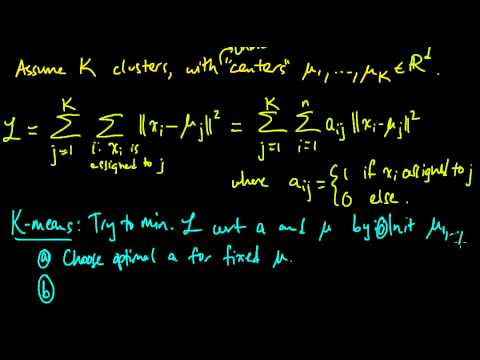

In [23]:
from IPython.display import YouTubeVideo
YouTubeVideo('0MQEt10e4NM')

## Gaussian Mixture Models

 - Model data as mixture of $K$ Gaussian distributions
 \begin{align}
  p(x)=\sum_{i=1}^K &\phi_i \mathcal{N}(x|\mu_i, \Sigma_i) \\
  \text{s.t.}& \\
  &\phi_i > 0\; \forall \; i \\
  \sum_{i=1}^K &\phi_i = 1 \\
  p(x) > &0\; \forall\; x \\
  \int p(x) = &1
 \end{align}


In [24]:
%%capture
%matplotlib inline
#%config InlineBackend.print_figure_kwargs={'bbox_inches':'tight'}
def run_cell_gmm_1d_fig(y_range=0.3, n_samples=500, x_samples=100):
    np.random.seed(1)
    m1, m2 = (-1.5, 1.5)
    s1, s2 = np.random.rand(2)
    phi1 = 0.5
    phi2 = 1 - phi1
    x = np.linspace(-4, 4, x_samples)
    pdf = scipy.stats.norm.pdf
    pdf1 = pdf(x, m1, s1)
    pdf2 = pdf(x, m2, s2)
    y_offsets = np.random.rand(n_samples) * y_range

    def sample(n, phi):
        clusters = np.random.choice(2, size=n, p=[phi, 1-phi])
        smpl1 = np.random.randn(np.sum(clusters==0)) * s1 + m1
        smpl2 = np.random.randn(np.sum(clusters==1)) * s2 + m2
        return np.append(smpl1, smpl2)
    
    def set_phi(phi):
        gmm_1d_fig, gmm_1d_ax = subplots()
        l1, = gmm_1d_ax.plot(x, pdf1, alpha=0.5)
        l2, = gmm_1d_ax.plot(x, pdf2, alpha=0.5)
        joint, = gmm_1d_ax.plot(x, phi * pdf1 + (1-phi) * pdf2, c='k')
        x_offsets = sample(n=n_samples, phi=phi)
        scatter = gmm_1d_ax.scatter(x_offsets, y_offsets, c='k', alpha=0.1)
        gmm_1d_ax.set_xticks([])
        gmm_1d_ax.set_yticks([])
        plt.show()
    return set_phi

In [25]:
%matplotlib inline
gmm_1d_set_phi = run_cell_gmm_1d_fig(y_range=0.3, n_samples=500, x_samples=1000)
@ipywidgets.interact(phi=(0.0, 1.0, 0.1))
def update(phi):
    gmm_1d_set_phi(1-phi)


interactive(children=(FloatSlider(value=0.5, description='phi', max=1.0), Output()), _dom_classes=('widget-int…

In [26]:
%%capture
%matplotlib inline
from mpl_toolkits.mplot3d import Axes3D
def run_cell_bivariate_3d():
    np.random.seed(6)
    m1, m2 = ((-1.5, -2), (1.5, 2))
    a1 = 3 * np.random.rand(4).reshape((2, 2))
    a2 = 3 * np.random.rand(4).reshape((2, 2))
    s1 = np.dot(a1.T, a1)
    s2 = np.dot(a2.T, a2)

    N = 100
    X = np.linspace(-3, 3, N)
    Y = np.linspace(-3, 3, N)
    x, y = np.meshgrid(X, Y)
    pos = np.empty(x.shape + (2,))
    pos[..., 0] = x
    pos[..., 1] = y
    pdf = scipy.stats.multivariate_normal.pdf
    pdf1 = pdf(pos, m1, s1)
    pdf2 = pdf(pos, m2, s2)
    maxval = max(np.max(pdf1), np.max(pdf2))

    def show_two_bivariates(phi, alpha_3d=1.0, n_samples=500):
        gmm_2d_fig = plt.figure(figsize=(15,15))
        gmm_2d_ax1 = gmm_2d_fig.add_subplot(1, 3, 1, projection='3d')
        gmm_2d_ax2 = gmm_2d_fig.add_subplot(1, 3, 2, projection='3d')
        gmm_2d_ax3 = gmm_2d_fig.add_subplot(1, 3, 3, projection='3d')
        
        def set_xlim(ax, x_max=3, x_min=-3):
            ax.set_xlim(x_min, x_max)
            
        def set_ylim(ax, y_max=3, y_min=-3):
            ax.set_ylim(y_min, y_max)
        
        def set_zlim(ax, z_max, z_min=0):
            ax.set_zlim(z_min, z_max)
        
        def set_ticks(ax, x=[], y=[], z=[]):
            ax.set_xticks(x)
            ax.set_yticks(y)
            ax.set_zticks(z)
            
        def sample(n, phi):
            clusters = np.random.choice(2, size=n, p=[phi, 1-phi])
            smpl1 = np.random.multivariate_normal(m1, s1, size=np.sum(clusters==0))
            smpl2 = np.random.multivariate_normal(m2, s2, size=np.sum(clusters==1))
            return np.append(smpl1, smpl2, axis=0)
        
        sampled = sample(n_samples, phi)
            
        offset_2d = -0.025
        set_zlim(gmm_2d_ax1, z_max=maxval, z_min=offset_2d)
        set_zlim(gmm_2d_ax2, z_max=maxval, z_min=offset_2d)
        set_zlim(gmm_2d_ax3, z_max=maxval, z_min=offset_2d)
        
        set_xlim(gmm_2d_ax1)
        set_xlim(gmm_2d_ax2)
        set_xlim(gmm_2d_ax3)
        
        set_ylim(gmm_2d_ax1)
        set_ylim(gmm_2d_ax2)
        set_ylim(gmm_2d_ax3)
            
        set_ticks(gmm_2d_ax1, z=[0,0.05])
        set_ticks(gmm_2d_ax2, z=[0,0.05])
        set_ticks(gmm_2d_ax3, z=[0,0.05])
        
        kwargs = dict(rstride=3, cstride=3, linewidth=1, antialiased=True, alpha=alpha_3d)
        c1 = gmm_2d_ax1.plot_surface(x, y, pdf1, cmap='viridis', **kwargs)#, vmax=0.99, vmin=0.01)
        c2 = gmm_2d_ax2.plot_surface(x, y, pdf2, cmap='viridis', **kwargs)#, vmax=0.99, vmin=0.01)
        phi1 = phi
        phi2 = 1.0 - phi1
        combination = phi1 * pdf1 + phi2 * pdf2
        joint = gmm_2d_ax3.plot_surface(x, y, combination, cmap='viridis', **kwargs)
        
        gmm_2d_ax1.contour(x, y, pdf1, cmap='viridis', offset=offset_2d)
        gmm_2d_ax2.contour(x, y, pdf2, cmap='viridis', offset=offset_2d)
        gmm_2d_ax3.contour(x, y, combination, cmap='viridis', offset=offset_2d)
        
        gmm_2d_ax3.scatter(sampled[...,0], sampled[...,1], offset_2d, alpha=0.4, c='k')

        gmm_2d_ax1.view_init(30, -45)
        gmm_2d_ax2.view_init(30, -45)
        gmm_2d_ax3.view_init(30, -45)

        return gmm_2d_fig
    return show_two_bivariates

In [27]:
%matplotlib inline
show_two_bivariates = run_cell_bivariate_3d()
@ipywidgets.interact(phi=(0.0, 1.0, 0.1), n_samples=(0, 1000, 50))
def update(phi, n_samples):
    show_two_bivariates(1.0-phi, alpha_3d=1.0, n_samples=n_samples)

interactive(children=(FloatSlider(value=0.5, description='phi', max=1.0), IntSlider(value=500, description='n_…

### Inferring the Parameters

 - Data $X=(x_1, \dots, x_N)$
 - Maximize (log-)likelihood: 
 
\begin{align}
   (\hat{\Phi}, \hat{\mu}, \hat{\Sigma}) = &\arg \max_{(\Phi, \mu, \Sigma)} p(X|\Phi, \mu, \Sigma)\\
          = &\arg \max_{(\Phi, \mu, \Sigma)} \prod_{x\in X} p(x|\Phi, \mu, \Sigma)\\
          = &\arg \max_{(\Phi, \mu, \Sigma)} \prod_{x\in X} \sum_{i=1}^K \phi_i \mathcal{N}(x|\mu_i, \Sigma_i) \\
          = &\arg \max_{(\Phi, \mu, \Sigma)} \sum_{x\in X} \log (\sum_{i=1}^K \phi_i \mathcal{N}(x|\mu_i, \Sigma_i))
\end{align}

### Introduce Latent Variable
 - log-likelihood hard to maximize due to sum inside log
 - introduce latent (unobserved) variable
   - can use expectation maximization for maximum likelihood estimator

 \begin{align}
 z \in \{0, 1\}^K \\
 \sum_{i=1}^K z_i = 1 \\
 p(z) = \prod_{i=1}^K\phi_i^{z_i}
 \end{align}

### Conditional Probability
\begin{align}
 p(x|z_i = 1) = & \mathcal{N}(x|\mu_i, \Sigma_i) \\
 p(x|z)       = & \prod_{i=1}^K \mathcal{N}(x|\mu_i, \Sigma_i)^{z_i}
\end{align}

### Joint Probability
\begin{align}
p(x, z) = &p(x|z) p(z) \\
        = &\prod_{i=1}^K \mathcal{N}(x|\mu_i, \Sigma_i)^{z_i} \times \prod_{i=1}^K\phi_i^{z_i} \\
p(x)    = &\sum_z p(x, z) = \sum_{i=1}^K \phi_i \mathcal{N}(x|\mu_i, \Sigma_i)
\end{align}

### Responsibilities

\begin{align}
\gamma(z_i)  = &p(z_i=1|x) \\
\gamma(z_{ni}) = &p(z_i=1|X_n) \\
N_i &= \sum_{n=1}^N \gamma(z_{ni})
\end{align}

### Expectation Maximization

 - Algorithm for optimizing ML estimators for models with latent (unknown)
 - General concept:
   1. **Expectation**-step: create a function for the expectation of log-likelihood given current parameters
   2. **Maximization**-step: Update parameters by maximizing expected log-likelihood 
   3. Repeat until conversion

### Expectation Maximimization for GMM
 1. Initialize parameters $(\phi, \mu, \Sigma)$
 2. **Expectation**-step: evaluate responsibilities
\begin{align}
\gamma(z_{ni}) = \frac{\phi_i \mathcal{N}(x|\mu_i, \Sigma_i)}{\sum_{k=1}^K \phi_k \mathcal{N}(x|\mu_k, \Sigma_k)}
\end{align}
 3. **Maximization**-step: update parameters
 \begin{align}
 \mu_i^{\text{new}}    = &\frac{1}{N_i}\sum_{n=1}^N\gamma(z_{ni})X_n \\
 \Sigma_i^{\text{new}} = &\frac{1}{N_i}\sum_{n=1}^N\gamma(z_{ni})(X_n-\mu_i^{\text{new}})(X_n-\mu_i^{\text{new}})^T \\
 \phi_i^{\text{new}}    = &\frac{N_i}{N}
 \end{align}
 4. Repeat (2) and (3) until convergence

### Comparison to KMeans

- Yay!    
  - We can sample from it!
  - Clusters can be anisotropic!
  - Clusters can vary in size!

 - Nay!
   - Sensitive to initialization
   - Only convex clusters
   - Number of clusters is parameter

In [28]:
%%capture
def create_gmm_compare_kmeans(data, figax, n_clusters=None):
    fig, (ax1, ax2, ax3) = figax
    ax1.clear()
    ax2.clear()
    ax3.clear()
    if not n_clusters:
        n_clusters = np.unique(data[1]).size
    kmeans = sklearn.cluster.KMeans(n_clusters=n_clusters)
    assignments = kmeans.fit_predict(data[0])
    colors = equidistant_colors(n_clusters)
    scatter_data(data[0], ax=ax1, color=colors[assignments])
    scatter_data(kmeans.cluster_centers_, ax=ax1, color=colors, alpha=1.0, marker='d', s=100, edgecolors='k')
    
    gmm = sklearn.mixture.GaussianMixture(n_components=n_clusters)
    gmm.fit(data[0])
    assignments = gmm.predict(data[0])
    
    m = np.min(data[0], axis=0)
    M = np.max(data[0], axis=0)
    X, Y = [np.linspace(l, u, 100) for l, u in zip(m, M)]
    X, Y = np.meshgrid(X, Y)
    XY = np.empty (X.shape + (2,))
    XY[..., 0] = X
    XY[..., 1] = Y
    Z = -gmm.score_samples(XY.reshape((np.prod(XY.shape[:2]), XY.shape[2])))
    ax2.contour(X, Y, Z.reshape(X.shape), cmap='Greys_r', norm=matplotlib.colors.LogNorm(vmin=1.0, vmax=1000.0), levels=np.logspace(0, 3, 10), alpha=0.3)
    
    scatter_data(data[0], ax=ax2, color=colors[assignments])
    scatter_data(gmm.means_, ax=ax2, color=colors, alpha=1.0, marker='d', s=100 * gmm.weights_ / np.max(gmm.weights_), edgecolors='k')
    
    scatter_data(data[0], ax=ax3, color=colors[data[1]])
    
    ax1.set_title('KMeans')
    ax2.set_title('GMM')
    ax3.set_title('Ground Truth')
    
    return fig

In [29]:
%%capture
gmm_compare_kmeans_blobs = subplots(ncols=3)
def create_gmm_compare_kmeans_blobs(figax=gmm_compare_kmeans_blobs):
    return create_gmm_compare_kmeans(data=blobs, figax=figax)

gmm_compare_kmeans_noisy_circles = subplots(ncols=3)
def create_gmm_compare_kmeans_noisy_circles(figax=gmm_compare_kmeans_noisy_circles):
    return create_gmm_compare_kmeans(data=noisy_circles, figax=figax)

gmm_compare_kmeans_no_structure = subplots(ncols=3)
def create_gmm_compare_kmeans_no_structure(figax=gmm_compare_kmeans_no_structure, n_clusters=1):
    return create_gmm_compare_kmeans(data=no_structure, figax=figax, n_clusters=n_clusters)

gmm_compare_kmeans_noisy_moons = subplots(ncols=3)
def create_gmm_compare_kmeans_noisy_moons(figax=gmm_compare_kmeans_noisy_moons):
    return create_gmm_compare_kmeans(data=noisy_moons, figax=figax)

gmm_compare_kmeans_vary_size = subplots(ncols=3)
def create_gmm_compare_kmeans_vary_size(figax=gmm_compare_kmeans_vary_size):
    return create_gmm_compare_kmeans(data=varied, figax=figax)

gmm_compare_kmeans_anisotropic = subplots(ncols=3)
def create_gmm_compare_kmeans_anisotropic(figax=gmm_compare_kmeans_anisotropic):
    return create_gmm_compare_kmeans(data=aniso, figax=figax)

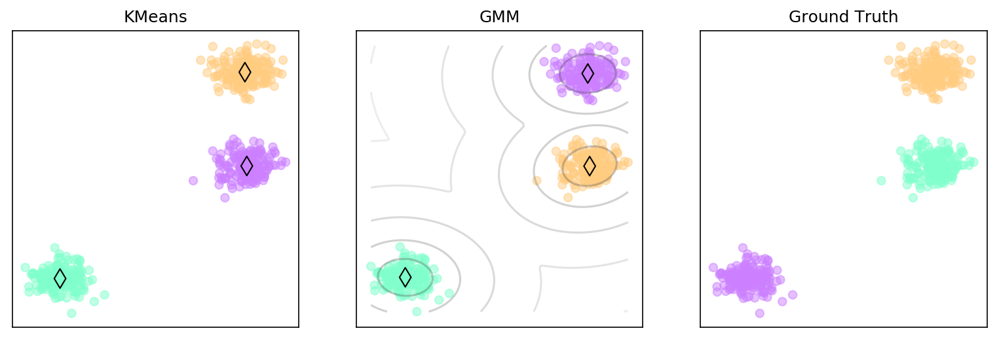

In [30]:
create_gmm_compare_kmeans_blobs()

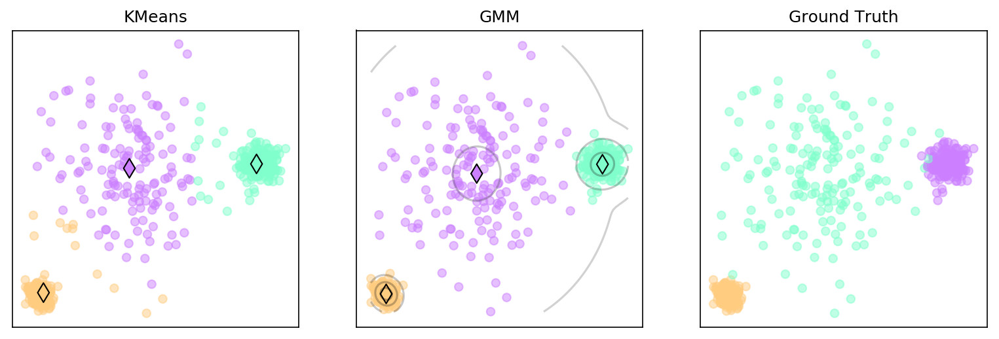

In [31]:
create_gmm_compare_kmeans_vary_size()

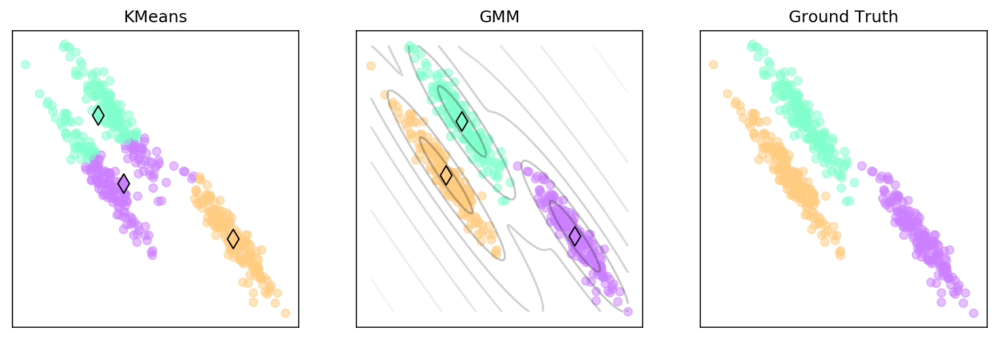

In [32]:
%matplotlib inline
create_gmm_compare_kmeans_anisotropic()

### Failure Examples

In [33]:
%%capture
target_time = 15000
weights, means, covariances, precisions, assignments, models = gmm(blobs[0], 3, 50, init_params='random')
gmm_animation = animate_gmm(models, blobs[0], weights, means, covariances, assignments, target_time=target_time)

In [34]:
%matplotlib inline
show_animation(gmm_animation)

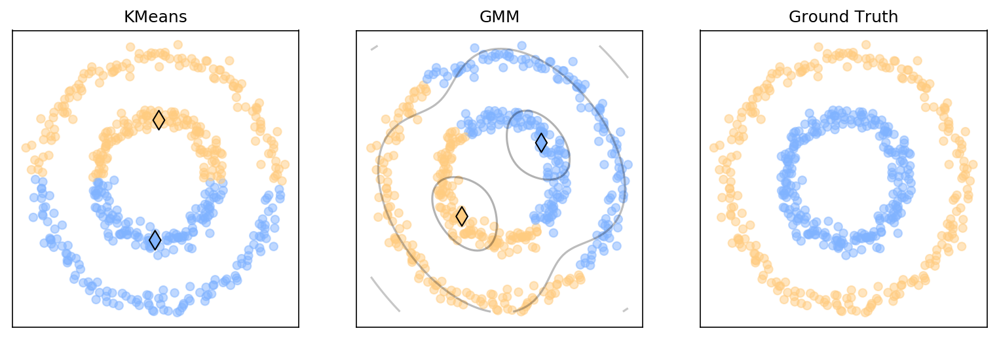

In [35]:
create_gmm_compare_kmeans_noisy_circles()

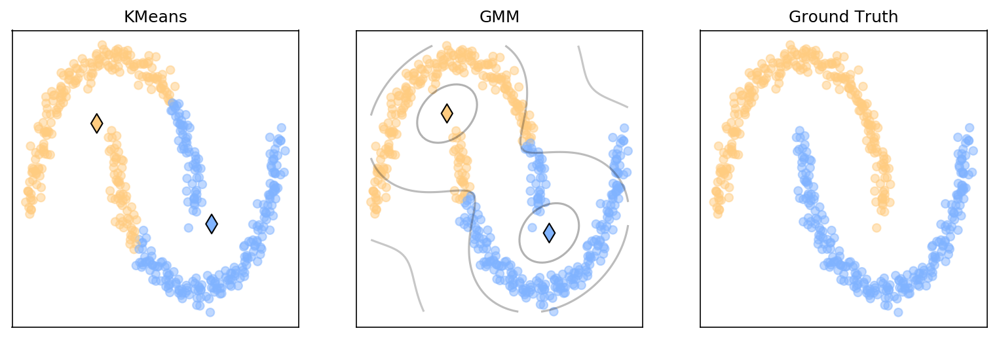

In [36]:
create_gmm_compare_kmeans_noisy_moons()

/usr/lib/python3.7/site-packages/matplotlib/contour.py:1544: UserWarning: Log scale: values of z <= 0 have been masked
  warnings.warn('Log scale: values of z <= 0 have been masked')


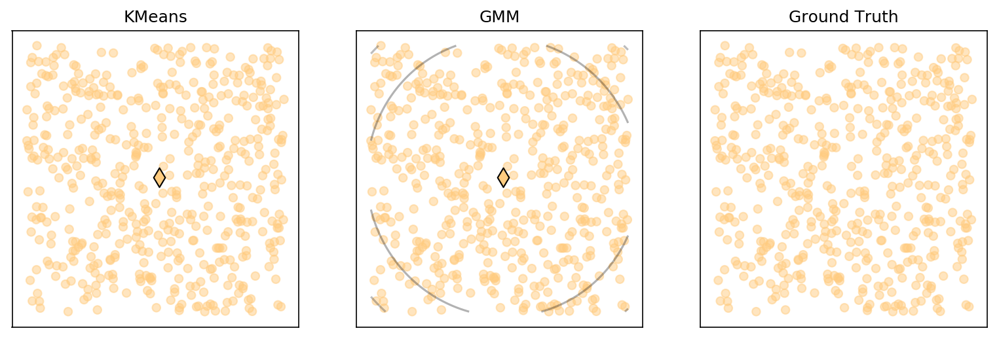

In [37]:
create_gmm_compare_kmeans_no_structure()

/usr/lib/python3.7/site-packages/matplotlib/contour.py:1544: UserWarning: Log scale: values of z <= 0 have been masked
  warnings.warn('Log scale: values of z <= 0 have been masked')


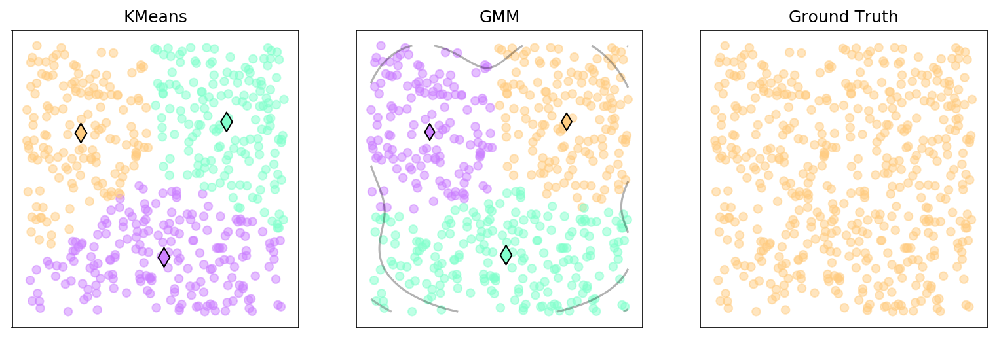

In [38]:
create_gmm_compare_kmeans_no_structure(n_clusters=3)

### Further Reading Gaussian Mixture Model

 - Barber, D - [Bayesian Reasoning and Machine Learning ch. 20.3](http://www0.cs.ucl.ac.uk/staff/d.barber/brml/) (http://www0.cs.ucl.ac.uk/staff/d.barber/brml/)

 - [GMM: mathematicalmonk@youtube ML 16.6](https://www.youtube.com/watch?v=Rkl30Fr2S38)

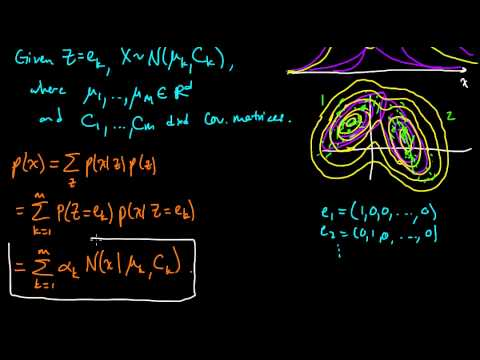

In [39]:
from IPython.display import YouTubeVideo
YouTubeVideo('Rkl30Fr2S38')

### Further Reading Expectation Maximization

 - Barber, D - [Bayesian Reasoning and Machine Learning chs. 11.2, 20.2](http://www0.cs.ucl.ac.uk/staff/d.barber/brml/) (http://www0.cs.ucl.ac.uk/staff/d.barber/brml/)

 - [GMM: mathematicalmonk@youtube ML 16.3](https://www.youtube.com/watch?v=AnbiNaVp3eQ)

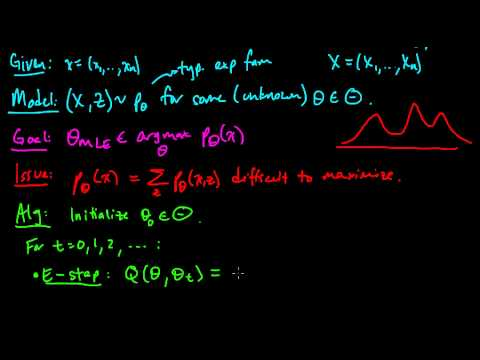

In [40]:
from IPython.display import YouTubeVideo
YouTubeVideo('AnbiNaVp3eQ')

## DBSCAN

 - Partition $X$ into
   - core points
   - (directly) reachable points
   - outliers

### Core Points
 Consider 
   - A distance measure between two points $p_1, p_2$: 
      \begin{align}d(p_1, p_2)\end{align}
   - The $\epsilon$-neighborhood of a point $p$: 
      \begin{align}\mathcal{N}_\epsilon(p) = \{\tilde{p} : d(\tilde{p},p)\} < \epsilon\end{align}
   - A minimum number of points $m$.
   
The set of core points is defined as
 \begin{align}
 \mathcal{C} = \{p : |\mathcal{N}_\epsilon(p)| \geq m\}
 \end{align}

### Directly Reachable Points
 - Point $q$ is directly reachable from $p \in \mathcal{C}$ if
    \begin{align}
    d(p,q) < \epsilon
    \end{align}

 - Set of all directly reachable points from $p \in \mathcal{C}$:
   \begin{align}
   \mathcal{R}(p) = \{q : d(p,q) < \epsilon\}
   \end{align}

### Rechable Points

 - Point $q$ is reachable from $p \in \mathcal{C}$ if there is a path $p_1,\dots,p_n$, such that
 
    \begin{align}
    p_1 = &p \\
    p_n = &q \\
    p_1, \dots, p_{n-1} \in &\mathcal{C} \\
    p_{i+1} \in &\mathcal{R}(p_i)
    \end{align}

### Clusters
 - Each core point $p \in \mathcal{C}$ forms a cluster with all points reachable from $p$
 - All other points (non-reachable) are outliers

In [41]:
#%%capture
def run_dbscan_visualization(br=[+4., +4.], tl=[-4., -4.], n_samples_per_cluster=[10, 10], seed=None):
    if seed:
        np.random.seed(seed)
    tl = np.array(tl)
    br = np.array(br)
    size = br - tl
    means = [np.random.rand(2) + tl + 0.3 * size, np.random.rand(2) + tl + 0.6 * size]
    a1 = np.random.rand(4).reshape(2, 2)
    a2 = np.random.rand(4).reshape(2, 2)
    s1 = np.dot(a1.T, a1)
    s2 = np.dot(a2.T, a2)
    points=np.concatenate([np.random.multivariate_normal(m, c, size=n) for m, c, n in zip(means, [s1, s2], n_samples_per_cluster)])
    n_samples = points.shape[0]
    min_x, min_y = np.min(points, axis=0) - 0.1 * size
    max_x, max_y = np.max(points, axis=0) + 0.1 * size
    
    class ParamSetter(object):
        def __init__(self):
            self.eps = 0.5
            self.min_samples = n_samples + 1
            self.metric = 'euclidean'
            self.regular_color = equidistant_colors(2)[0]
            self.outlier_color = equidistant_colors(2)[1]
            
        def set_params(self, eps, min_samples):
            needs_update = False
            if self.min_samples != min_samples:
                self.min_samples = min_samples
                needs_update = True
            if self.eps != eps:
                self.eps = eps
                needs_update = True
            if needs_update:
                self._update()
                
            
        def set_eps(self, eps):
            if self.eps > 0 and self.eps != eps:
                self.eps = eps
                self._update()
                
        def set_min_samples(self, min_samples):
            if self.min_samples != min_samples:
                self.min_samples = min_samples
                self._update()
                
        def set_metric(self, metric):
            if self.metric != metric:
                self.metric = metric
                self._update()
                
        def _update(self):
            model = sklearn.cluster.DBSCAN(eps=self.eps, min_samples=self.min_samples, metric=self.metric)
            model.fit(points)
            fig, ax = subplots()
            is_reachable = model.labels_ >= 0
            reachable = points[is_reachable]
            core = points[model.core_sample_indices_]
            outliers = points[model.labels_ < 0]
            colors = equidistant_colors(max(np.max(model.labels_) + 1, 1))
            size = 50
            ax.scatter(reachable[:, 0], reachable[:, 1], c=colors[model.labels_[is_reachable]], s=size, alpha=0.5)
            ax.scatter(core[:, 0], core[:, 1], c=colors[model.labels_[model.core_sample_indices_]], marker='d', s=2.0*size)
            ax.scatter(outliers[:, 0], outliers[:, 1], c='k', s=size, alpha=0.3)
            circles = [matplotlib.patches.Circle(p, self.eps, color='k', fill=False, alpha=0.1) for p in points]
            for c in circles:
                ax.add_patch(c)
            ax.set_xlim(min_x, max_x)
            ax.set_ylim(min_y, max_y)
            plt.show()
            
    return ParamSetter()

In [42]:
%matplotlib inline
setter = run_dbscan_visualization(seed=10, n_samples_per_cluster=[15, 15])
@ipywidgets.interact(eps=(0.05, 4, 0.05), min_samples=(1, 31, 1))
def set_params(eps, min_samples):
    setter.set_params(eps, min_samples)

interactive(children=(FloatSlider(value=2.0, description='eps', max=4.0, min=0.05, step=0.05), IntSlider(value…

In [43]:
%%capture
def create_compare_kmeans_gmm_dbscan(data, figax, eps, min_samples, n_clusters=None):
    fig, (ax1, ax2, ax3, ax4) = figax
    ax1.clear()
    ax2.clear()
    ax3.clear()
    if not n_clusters:
        n_clusters = np.unique(data[1]).size
    kmeans = sklearn.cluster.KMeans(n_clusters=n_clusters)
    assignments = kmeans.fit_predict(data[0])
    colors = equidistant_colors(n_clusters)
    scatter_data(data[0], ax=ax1, color=colors[assignments])
    scatter_data(kmeans.cluster_centers_, ax=ax1, color=colors, alpha=1.0, marker='d', s=100, edgecolors='k')
    
    gmm = sklearn.mixture.GaussianMixture(n_components=n_clusters)
    gmm.fit(data[0])
    assignments = gmm.predict(data[0])
    
    m = np.min(data[0], axis=0)
    M = np.max(data[0], axis=0)
    X, Y = [np.linspace(l, u, 100) for l, u in zip(m, M)]
    X, Y = np.meshgrid(X, Y)
    XY = np.empty (X.shape + (2,))
    XY[..., 0] = X
    XY[..., 1] = Y
    Z = -gmm.score_samples(XY.reshape((np.prod(XY.shape[:2]), XY.shape[2])))
    ax2.contour(X, Y, Z.reshape(X.shape), cmap='Greys_r', norm=matplotlib.colors.LogNorm(vmin=1.0, vmax=1000.0), levels=np.logspace(0, 3, 10), alpha=0.3)
    
    scatter_data(data[0], ax=ax2, color=colors[assignments])
    scatter_data(gmm.means_, ax=ax2, color=colors, alpha=1.0, marker='d', s=100 * gmm.weights_ / np.max(gmm.weights_), edgecolors='k')
    
    
    
    dbscan = sklearn.cluster.DBSCAN(min_samples=min_samples, eps=eps)
    assignments = dbscan.fit_predict(data[0])
    
    is_reachable = dbscan.labels_ >= 0
    reachable = data[0][is_reachable]
    core = data[0][dbscan.core_sample_indices_]
    outliers = data[0][dbscan.labels_ < 0]
    dbscan_colors = equidistant_colors(max(np.max(dbscan.labels_) + 1, 1))
    scatter_data(reachable, ax=ax3, color=dbscan_colors[dbscan.labels_[is_reachable]], alpha=0.5)#, s=100)
    #ax3.scatter(core[:, 0], core[:, 1], c=dbscan_colors[dbscan.labels_[dbscan.core_sample_indices_]], marker='d', s=2.0*100)
    scatter_data(outliers, ax=ax3, color='k', alpha=0.3)#, s=100)

    scatter_data(data[0], ax=ax4, color=colors[data[1]])
    
    ax1.set_title('KMeans')
    ax2.set_title('GMM')
    ax3.set_title('DBSCAN')
    ax4.set_title('Ground Truth')
    
    return fig

In [44]:
%%capture
compare_kmeans_gmm_dbscan_blobs = subplots(ncols=4)
def create_compare_kmeans_gmm_dbscan_blobs(eps, min_samples, figax=compare_kmeans_gmm_dbscan_blobs):
    return create_compare_kmeans_gmm_dbscan(data=blobs, figax=figax, eps=eps, min_samples=min_samples)

compare_kmeans_gmm_dbscan_noisy_circles = subplots(ncols=4)
def create_compare_kmeans_gmm_dbscan_noisy_circles(eps, min_samples, figax=compare_kmeans_gmm_dbscan_noisy_circles):
    return create_compare_kmeans_gmm_dbscan(data=noisy_circles, figax=figax, eps=eps, min_samples=min_samples)

compare_kmeans_gmm_dbscan_noisy_moons = subplots(ncols=4)
def create_compare_kmeans_gmm_dbscan_noisy_moons(eps, min_samples, figax=compare_kmeans_gmm_dbscan_noisy_moons):
    return create_compare_kmeans_gmm_dbscan(data=noisy_moons, figax=figax, eps=eps, min_samples=min_samples)

compare_kmeans_gmm_dbscan_no_structure = subplots(ncols=4)
def create_compare_kmeans_gmm_dbscan_no_structure(eps, min_samples, figax=compare_kmeans_gmm_dbscan_no_structure, n_clusters=None):
    return create_compare_kmeans_gmm_dbscan(data=no_structure, figax=figax, eps=eps, min_samples=min_samples, n_clusters=n_clusters)

compare_kmeans_gmm_dbscan_vary_size = subplots(ncols=4)
def create_compare_kmeans_gmm_dbscan_vary_size(eps, min_samples, figax=compare_kmeans_gmm_dbscan_vary_size):
    return create_compare_kmeans_gmm_dbscan(data=varied, figax=figax, eps=eps, min_samples=min_samples)

compare_kmeans_gmm_dbscan_anisotropic = subplots(ncols=4)
def create_compare_kmeans_gmm_dbscan_anisotropic(eps, min_samples, figax=compare_kmeans_gmm_dbscan_anisotropic):
    return create_compare_kmeans_gmm_dbscan(data=aniso, figax=figax, eps=eps, min_samples=min_samples)

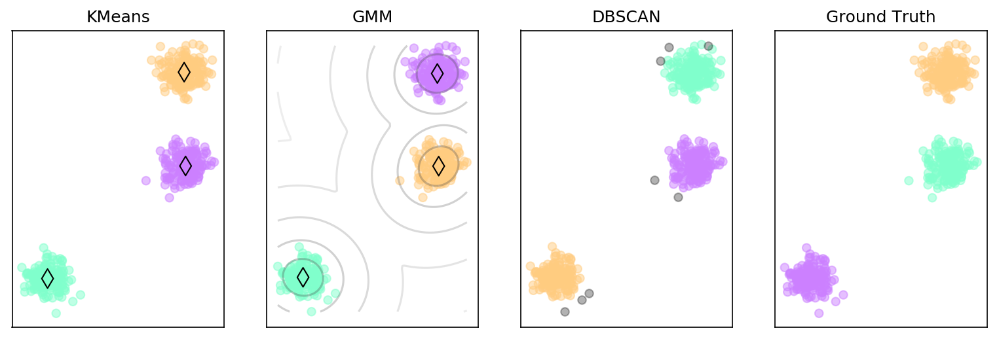

In [45]:
%matplotlib inline
create_compare_kmeans_gmm_dbscan_blobs(1.0, 10)

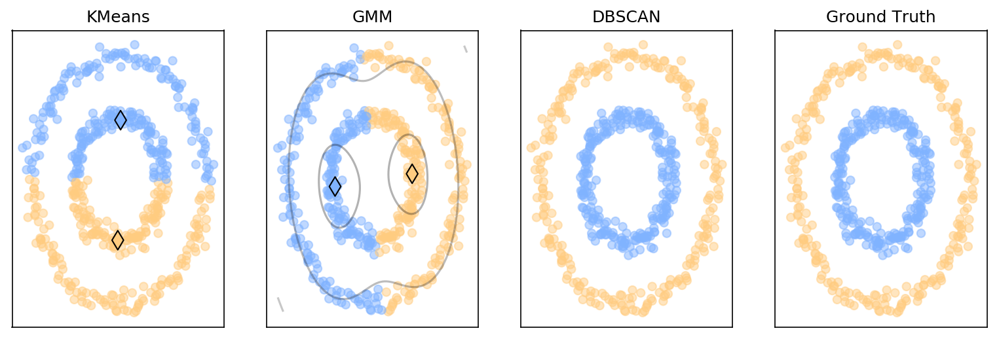

In [46]:
%matplotlib inline
create_compare_kmeans_gmm_dbscan_noisy_circles(0.2, 10)

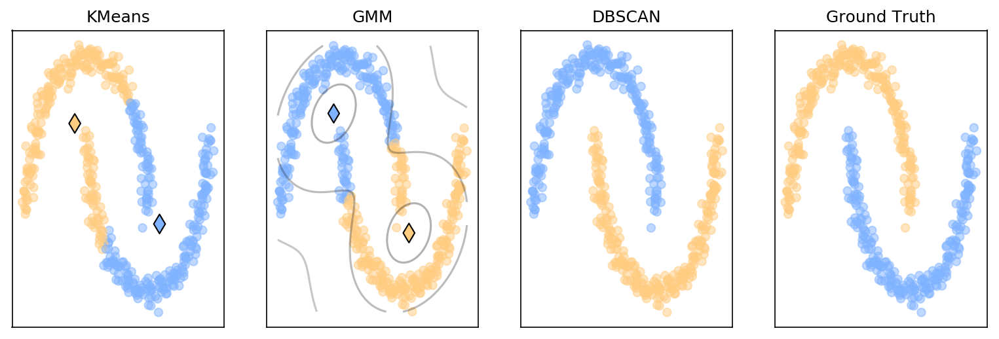

In [47]:
%matplotlib inline
create_compare_kmeans_gmm_dbscan_noisy_moons(0.2, 10)

/usr/lib/python3.7/site-packages/matplotlib/contour.py:1544: UserWarning: Log scale: values of z <= 0 have been masked
  warnings.warn('Log scale: values of z <= 0 have been masked')


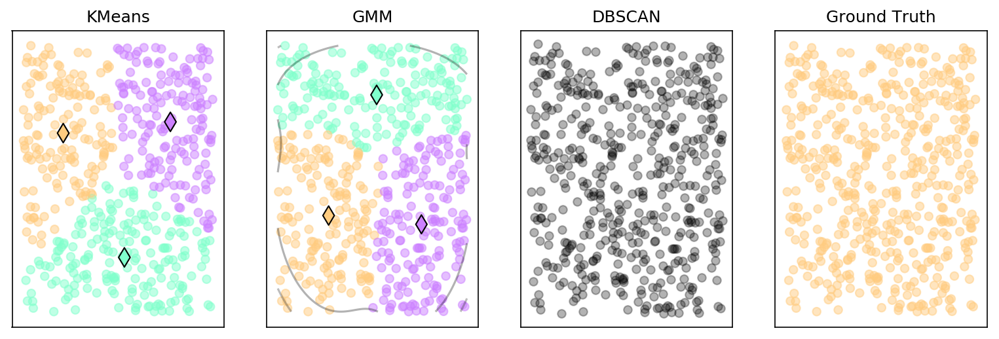

In [48]:
%matplotlib inline
create_compare_kmeans_gmm_dbscan_no_structure(0.1, 1000, n_clusters=3)

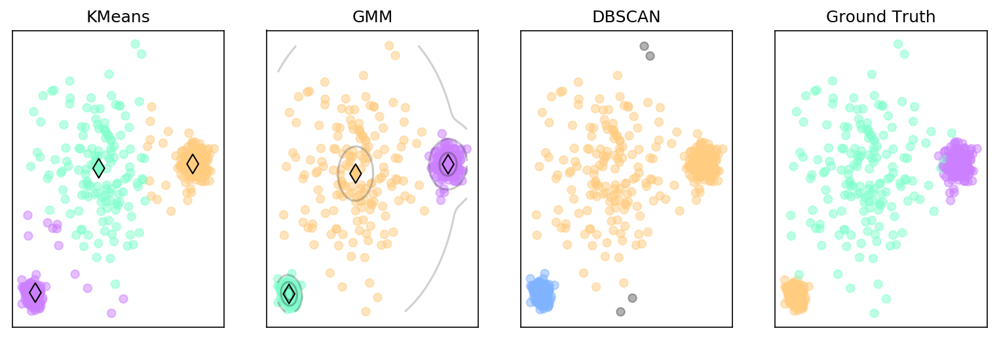

In [49]:
%matplotlib inline
create_compare_kmeans_gmm_dbscan_vary_size(2.0, 10)

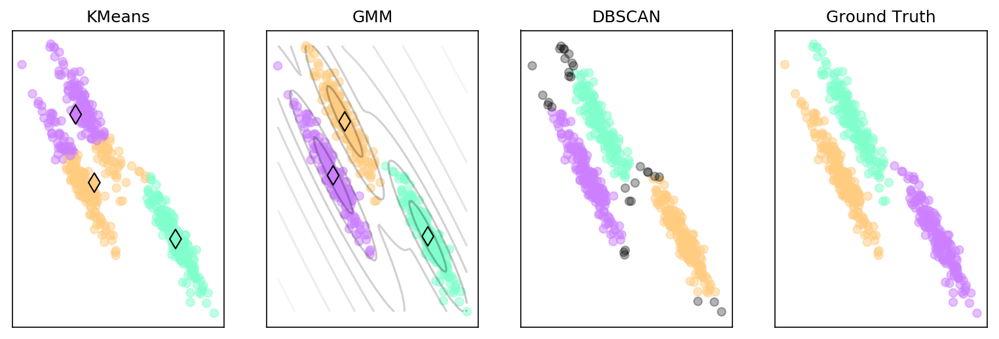

In [50]:
%matplotlib inline
create_compare_kmeans_gmm_dbscan_anisotropic(0.4, 10)